In [1]:
import sys
import os
import glob
import json
import pandas as pd
import numpy as np
import seaborn as sns
import matplotlib.pyplot as plt
import plotly.express as px
import plotly.graph_objects as go
%matplotlib inline

In [2]:
df = pd.read_csv('../../01 Data/03 Consolidated/authors_with_gender_v99.csv')

In [3]:
df

,paper_id,date,name,fname,lname,affiliationIds,new_fname,norm_fname,gender,year
0,10.1103/PhysRevApplied.9.039901,2018-03-06,Tomoyuki Sasaki,Tomoyuki,Sasaki,[],Tomoyuki,tomoyuki,NaN,2018
1,10.1103/PhysRevApplied.9.039901,2018-03-06,Yuichiro Ando,Yuichiro,Ando,[],Yuichiro,yuichiro,NaN,2018
2,10.1103/PhysRevApplied.9.039901,2018-03-06,Makoto Kameno,Makoto,Kameno,[],Makoto,makoto,male,2018
3,10.1103/PhysRevApplied.9.039901,2018-03-06,Takayuki Tahara,Takayuki,Tahara,[],Takayuki,takayuki,male,2018
4,10.1103/PhysRevApplied.9.039901,2018-03-06,Hayato Koike,Hayato,Koike,[],Hayato,hayato,NaN,2018
...,...,...,...,...,...,...,...,...,...,...
2503838,10.1103/PhysRevSTAB.14.014001,2011-01-21,Mikhail Zobov,Mikhail,Zobov,a2,Mikhail,mikhail,male,2011
2503839,10.1103/PhysRevSTAB.14.090401,2011-09-15,A. Lorusso,A.,Lorusso,a1,A.,a,NaN,2011
2503840,10.1103/PhysRevSTAB.14.090401,2011-09-15,F. Gontad,F.,Gontad,a1,F.,f,NaN,2011
2503841,10.1103/PhysRevSTAB.14.090401,2011-09-15,A. Perrone,A.,Perrone,a1,A.,a,NaN,2011


##### Make YR, YRMO

In [4]:
# Change format to datetime
df['date'] = df['date'].astype('datetime64[ns]')

# As no time val, extract date, yrmo, yr
df['YearMonth'] = df['date'].map(lambda x: 100*x.year + x.month)

In [5]:
df

,paper_id,date,name,fname,lname,affiliationIds,new_fname,norm_fname,gender,year,YearMonth
0,10.1103/PhysRevApplied.9.039901,2018-03-06,Tomoyuki Sasaki,Tomoyuki,Sasaki,[],Tomoyuki,tomoyuki,NaN,2018,201803
1,10.1103/PhysRevApplied.9.039901,2018-03-06,Yuichiro Ando,Yuichiro,Ando,[],Yuichiro,yuichiro,NaN,2018,201803
2,10.1103/PhysRevApplied.9.039901,2018-03-06,Makoto Kameno,Makoto,Kameno,[],Makoto,makoto,male,2018,201803
3,10.1103/PhysRevApplied.9.039901,2018-03-06,Takayuki Tahara,Takayuki,Tahara,[],Takayuki,takayuki,male,2018,201803
4,10.1103/PhysRevApplied.9.039901,2018-03-06,Hayato Koike,Hayato,Koike,[],Hayato,hayato,NaN,2018,201803
...,...,...,...,...,...,...,...,...,...,...,...
2503838,10.1103/PhysRevSTAB.14.014001,2011-01-21,Mikhail Zobov,Mikhail,Zobov,a2,Mikhail,mikhail,male,2011,201101
2503839,10.1103/PhysRevSTAB.14.090401,2011-09-15,A. Lorusso,A.,Lorusso,a1,A.,a,NaN,2011,201109
2503840,10.1103/PhysRevSTAB.14.090401,2011-09-15,F. Gontad,F.,Gontad,a1,F.,f,NaN,2011,201109
2503841,10.1103/PhysRevSTAB.14.090401,2011-09-15,A. Perrone,A.,Perrone,a1,A.,a,NaN,2011,201109


(array([  0,   1,   2,   3,   4,   5,   6,   7,   8,   9,  10,  11,  12,
         13,  14,  15,  16,  17,  18,  19,  20,  21,  22,  23,  24,  25,
         26,  27,  28,  29,  30,  31,  32,  33,  34,  35,  36,  37,  38,
         39,  40,  41,  42,  43,  44,  45,  46,  47,  48,  49,  50,  51,
         52,  53,  54,  55,  56,  57,  58,  59,  60,  61,  62,  63,  64,
         65,  66,  67,  68,  69,  70,  71,  72,  73,  74,  75,  76,  77,
         78,  79,  80,  81,  82,  83,  84,  85,  86,  87,  88,  89,  90,
         91,  92,  93,  94,  95,  96,  97,  98,  99, 100, 101, 102, 103,
        104, 105, 106, 107, 108, 109, 110, 111, 112, 113, 114, 115, 116,
        117, 118, 119, 120, 121, 122, 123, 124, 125]),
 <a list of 126 Text xticklabel objects>)

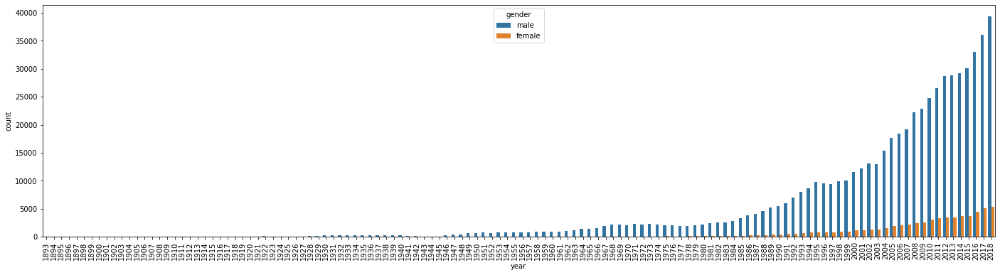

In [6]:
plt.figure(figsize=(24,6))
sns.countplot(df.year, hue=df.gender)
plt.xticks(rotation=90)

## Career Lengths

In [7]:
# Data for only those authors for which we have gender info
df_time = df[(df['gender'] == 'female') | (df['gender'] == 'male')]

In [8]:
df_time

,paper_id,date,name,fname,lname,affiliationIds,new_fname,norm_fname,gender,year,YearMonth
2,10.1103/PhysRevApplied.9.039901,2018-03-06,Makoto Kameno,Makoto,Kameno,[],Makoto,makoto,male,2018,201803
3,10.1103/PhysRevApplied.9.039901,2018-03-06,Takayuki Tahara,Takayuki,Tahara,[],Takayuki,takayuki,male,2018,201803
7,10.1103/PhysRevApplied.9.039901,2018-03-06,Masashi Shiraishi,Masashi,Shiraishi,[],Masashi,masashi,male,2018,201803
8,10.1103/PhysRevApplied.9.029901,2018-02-15,Le Zhang,Le,Zhang,[],Le,le,male,2018,201802
10,10.1103/PhysRevApplied.9.029901,2018-02-15,Dong Wang,Dong,Wang,[],Dong,dong,male,2018,201802
...,...,...,...,...,...,...,...,...,...,...,...
2503834,10.1103/PhysRevSTAB.14.060710,2011-06-24,Gennady Stupakov,Gennady,Stupakov,a2,Gennady,gennady,male,2011,201106
2503835,10.1103/PhysRevSTAB.14.014001,2011-01-21,Dmitry Shatilov,Dmitry,Shatilov,a1,Dmitry,dmitry,male,2011,201101
2503836,10.1103/PhysRevSTAB.14.014001,2011-01-21,Eugene Levichev,Eugene,Levichev,a1,Eugene,eugene,male,2011,201101
2503837,10.1103/PhysRevSTAB.14.014001,2011-01-21,Evgeny Simonov,Evgeny,Simonov,a1,Evgeny,evgeny,male,2011,201101


In [9]:
df_age = df_time.groupby(['name','gender'], as_index=False).agg({'year':[np.min, np.max], 'paper_id': 'count'})

In [10]:
df_age

name gender  year       paper_id
                                        amin  amax    count
0                    A.A. Aczel   male  2011  2011        2
1                   A.A. Aligia   male  2003  2003        1
2                    A.A. Hasan   male  1999  1999        1
3                A.A. Ioannides   male  1998  1998        2
4                  A.A. Korneev   male  2018  2018        2
...                         ...    ...   ...   ...      ...
142699          the TEXTOR team   male  2006  2013       18
142700  the TFTR Operating Team   male  1989  1989        1
142701           the TJ-II Team   male  2017  2017        7
142702      the Tore Supra Team   male  2000  2000        1
142703           the W7-AS team   male  2001  2007        2

[142704 rows x 5 columns]

In [11]:
df_age['year_diff'] = df_age['year']['amax'] - df_age['year']['amin']
df_age.tail(5)

name gender  year       paper_id year_diff
                                        amin  amax    count          
142699          the TEXTOR team   male  2006  2013       18         7
142700  the TFTR Operating Team   male  1989  1989        1         0
142701           the TJ-II Team   male  2017  2017        7         0
142702      the Tore Supra Team   male  2000  2000        1         0
142703           the W7-AS team   male  2001  2007        2         6

##### Majority of Authors have 1 paper in the data, so their career spans = 0 if we only take the differnce. Hence, add 1 to all lengths, so even for a single occurence the career length is = 1 year

In [12]:
df_age['year_diff'] = df_age['year_diff'] + 1
df_age.tail(5)

name gender  year       paper_id year_diff
                                        amin  amax    count          
142699          the TEXTOR team   male  2006  2013       18         8
142700  the TFTR Operating Team   male  1989  1989        1         1
142701           the TJ-II Team   male  2017  2017        7         1
142702      the Tore Supra Team   male  2000  2000        1         1
142703           the W7-AS team   male  2001  2007        2         7

In [13]:
# QC
# df_age[df_age.name=='Alessandro Ferraro']

In [14]:
# Spot Check
# df[df.name=='A.A. Ioannides']
# df[df.name=='Akira Koyama']
# df[df.name=='Alessandro Ferraro']

### Keep data only for +-3 Standard Deviations  @ gender level
- 1 Standard Deviation from the Mean: 68%
- 2 Standard Deviations from the Mean: 95%
- 3 Standard Deviations from the Mean: **99.7%**

##### Process:
1. Split data into male and female dbs
2. Find menas and SDs
3. Clean outliers
4. Concat data again


##### Formula:
db[abs( val - mean) <= 3 * std)]

In [15]:
# Make new male db

# Old Results
male_db = df_age[df_age.gender=='male']
print('Males: mean=%.3f stdv=%.3f' % (np.mean(male_db.year_diff),  np.std(male_db.year_diff)))

# New Results
male_db = male_db[np.abs(male_db.year_diff - male_db.year_diff.mean()) <= (3 * male_db.year_diff.std())]
print('Males: mean=%.3f stdv=%.3f' % (np.mean(male_db.year_diff),  np.std(male_db.year_diff)))

Males: mean=5.528 stdv=8.165
Males: mean=4.703 stdv=6.224


In [16]:
# Make new female db

# Old Results
female_db = df_age[df_age.gender=='female']
print('Females: mean=%.3f stdv=%.3f' % (np.mean(female_db.year_diff),  np.std(female_db.year_diff)))

# New Results
female_db = female_db[np.abs(female_db.year_diff - female_db.year_diff.mean()) <= (3 * female_db.year_diff.std())]
print('Females: mean=%.3f stdv=%.3f' % (np.mean(female_db.year_diff),  np.std(female_db.year_diff)))

Females: mean=3.998 stdv=6.100
Females: mean=3.279 stdv=4.274


In [17]:
# # Old Results

# m = np.mean(yr_diff[yr_diff.gender=='male']['year_diff'])
# f = np.mean(yr_diff[yr_diff.gender=='female']['year_diff'])
# print('Males: Average publishing Time Periord: {0:0.2f} years'.format(m))
# print('Females: Average publishing Time Periord: {0:0.2f} years'.format(f))

# diff_prcnt = 100*abs(m-f)/((m+f)/2)
# male_ovr_fem = 100*abs(m-f)/f

# print('% diff b/w male and females publishing time period: {0:0.1f}%'.format(diff_prcnt))
# print('Males display a {0:0.1f}% longer publishing time period over women'.format(male_ovr_fem))

In [18]:
# New Results

m = np.mean(male_db['year_diff'])
f = np.mean(female_db['year_diff'])
print('Males: Average publishing Time Periord: {0:0.2f} years'.format(m))
print('Females: Average publishing Time Periord: {0:0.2f} years'.format(f))

diff_prcnt = 100*abs(m-f)/((m+f)/2)
male_ovr_fem = 100*abs(m-f)/f

print('% diff b/w male and females publishing time period: {0:0.1f}%'.format(diff_prcnt))
print('Males display a {0:0.1f}% longer publishing time period over women'.format(male_ovr_fem))

Males: Average publishing Time Periord: 4.70 years
Females: Average publishing Time Periord: 3.28 years
% diff b/w male and females publishing time period: 35.7%
Males display a 43.4% longer publishing time period over women


###### % diff b/w male and females publishing time period: 30%
###### Males display a 37% longer publishing time period over women

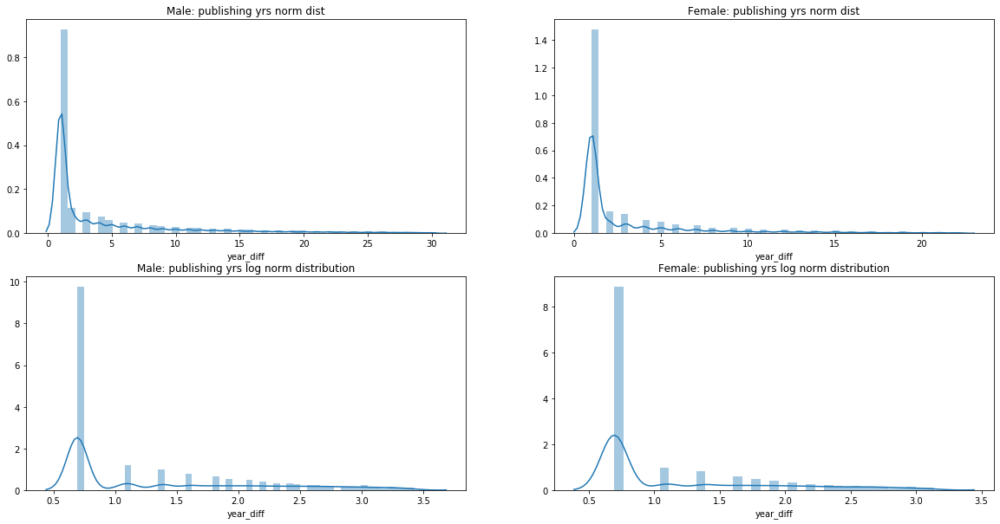

In [19]:
plt.figure(figsize=(20,10))
plt.subplot('221')
plt.title('Male: publishing yrs norm dist')
sns.distplot(male_db['year_diff'])
plt.subplot('222')
plt.title('Female: publishing yrs norm dist')
sns.distplot(female_db['year_diff'])
plt.subplot('223')
plt.title('Male: publishing yrs log norm distribution')
sns.distplot(male_db['year_diff'].apply(np.log1p))
plt.subplot('224')
plt.title('Female: publishing yrs log norm distribution')
sns.distplot(female_db['year_diff'].apply(np.log1p))

In [20]:
print('% of Female Authors with career length = only 1 yr: {0:0.1f}%'.format(100*len(female_db[female_db['year_diff'] == 1])/len(female_db)))

% of Female Authors with career length = only 1 yr: 61.9%


In [21]:
print('% of Male Authors with career length = only 1 yr: {0:0.1f}%'.format(100*len(male_db[male_db['year_diff'] == 1])/len(male_db)))

% of Male Authors with career length = only 1 yr: 53.6%


Merge DBs back together

In [22]:
frames = [male_db, female_db]
result = pd.concat(frames)

In [29]:
result.reset_index(drop=True)
result

name  gender  year       paper_id year_diff
                                         amin  amax    count          
0                    A.A. Aczel    male  2011  2011        2         1
1                   A.A. Aligia    male  2003  2003        1         1
2                    A.A. Hasan    male  1999  1999        1         1
3                A.A. Ioannides    male  1998  1998        2         1
4                  A.A. Korneev    male  2018  2018        2         1
...                         ...     ...   ...   ...      ...       ...
142651         Zulma A. Jiménez  female  2009  2014        5         6
142660  Zuzanna Liliental-Weber  female  2005  2012        2         8
142661          Zuzanna S. Siwy  female  2007  2009        2         3
142662             Zuzanna Siwy  female  1999  2002        3         4
142663          Zuzanna Sobczak  female  2017  2018        4         2

[139193 rows x 6 columns]

In [30]:
result.rename(columns={('year_diff',''):'academic_age'}, inplace=True)

In [31]:
result.columns

MultiIndex([(     'name',      ''),
            (   'gender',      ''),
            (     'year',  'amin'),
            (     'year',  'amax'),
            ( 'paper_id', 'count'),
            ('year_diff',      '')],
           )

In [32]:
df_res = pd.DataFrame()
df_res['name'] = result['name']
df_res['gender'] = result['gender']
df_res['year_min'] = result['year']['amin']
df_res['year_max'] = result['year']['amax']
df_res['paper_id_count'] = result['paper_id']['count']
df_res['academic_age'] = result[('year_diff','')]

In [33]:
df_res

,name,gender,year_min,year_max,paper_id_count,academic_age
0,A.A. Aczel,male,2011,2011,2,1
1,A.A. Aligia,male,2003,2003,1,1
2,A.A. Hasan,male,1999,1999,1,1
3,A.A. Ioannides,male,1998,1998,2,1
4,A.A. Korneev,male,2018,2018,2,1
...,...,...,...,...,...,...
142651,Zulma A. Jiménez,female,2009,2014,5,6
142660,Zuzanna Liliental-Weber,female,2005,2012,2,8
142661,Zuzanna S. Siwy,female,2007,2009,2,3
142662,Zuzanna Siwy,female,1999,2002,3,4


In [34]:
print('% Unique data: {0:0.1%}'.format(len(set(list(df_res.name)))/df_res.shape[0]))

% Unique data: 100.0%


In [35]:
df_res.gender.value_counts()

male      122046
female     17147
Name: gender, dtype: int64

In [36]:
# Library to write plotly images
# conda install -c plotly plotly-orca

In [52]:
fig = px.histogram(df_res, x="academic_age", color="gender", marginal="box",
                   hover_data=df_res.columns)
fig.write_image('../../04 Plots/Aacdemic_Age_Distribution_Male_v_Female.jpeg')
fig.show()

## Avg Publishing Rate

##### +- 3 Standard Deviations Cleaned Data

In [38]:
df_res['pprs_per_yr'] = df_res['paper_id_count']/df_res['academic_age']
df_res

,name,gender,year_min,year_max,paper_id_count,academic_age,pprs_per_yr
0,A.A. Aczel,male,2011,2011,2,1,2.000000
1,A.A. Aligia,male,2003,2003,1,1,1.000000
2,A.A. Hasan,male,1999,1999,1,1,1.000000
3,A.A. Ioannides,male,1998,1998,2,1,2.000000
4,A.A. Korneev,male,2018,2018,2,1,2.000000
...,...,...,...,...,...,...,...
142651,Zulma A. Jiménez,female,2009,2014,5,6,0.833333
142660,Zuzanna Liliental-Weber,female,2005,2012,2,8,0.250000
142661,Zuzanna S. Siwy,female,2007,2009,2,3,0.666667
142662,Zuzanna Siwy,female,1999,2002,3,4,0.750000


In [39]:
# df_res.to_csv('../../01 Data/03 Consolidated/uniq_author_gen_pprcount_age_v1', index=False)

###### Analysis on +- 3 Standard Deviations Cleaned Data

In [40]:
m = np.mean(df_res[df_res.gender=='male']['pprs_per_yr'])
f = np.mean(df_res[df_res.gender=='female']['pprs_per_yr'])
print('Males: average papers published per year: {0:0.2f} paper/year'.format(m))
print('Females: average papers published per year: {0:0.2f} paper/year'.format(f))

diff_prcnt = 100*abs(m-f)/((m+f)/2)
male_ovr_fem = 100*abs(m-f)/f

print('\n The % diff b/w male and females avg papers per year: {0:0.2f}%'.format(diff_prcnt))

Males: average papers published per year: 1.07 paper/year
Females: average papers published per year: 1.09 paper/year

 The % diff b/w male and females avg papers per year: 2.44%


##### Clean paper_id_count column

In [41]:
m2 = np.mean(df_res[df_res.gender=='male']['paper_id_count'])
f2 = np.mean(df_res[df_res.gender=='female']['paper_id_count'])
print('Males: average papers published in academic lifetime: {0:0.2f}'.format(m2))
print('Females: average papers published in academic lifetime: {0:0.2f}'.format(f2))

diff_prcnt2 = 100*abs(m2-f2)/((m2+f2)/2)
male_ovr_fem2 = 100*abs(m2-f2)/f2

print('\n The % diff b/w male and females avg papers in academic lifetime: {0:0.2f}%'.format(diff_prcnt2))
print('Males publish {0:0.2f}% more papers in lifetime over women'.format(male_ovr_fem2))

Males: average papers published in academic lifetime: 4.22
Females: average papers published in academic lifetime: 3.02

 The % diff b/w male and females avg papers in academic lifetime: 33.14%
Males publish 39.72% more papers in lifetime over women


In [42]:
# fig = px.histogram(df_res, x="paper_id_count", color="gender", marginal="box",
#                    hover_data=df_res.columns)
# # fig.write_image('../../04 Plots/Aacdemic_Age_Distribution_Male_v_Female.jpeg')
# fig.show()

In [43]:
# New Results
new2 = df_res
new2 = new2[np.abs(new2.paper_id_count - new2.paper_id_count.mean()) <= (3 * new2.paper_id_count.std())]
print('Paper_id: mean=%.3f stdv=%.3f' % (np.mean(new2.paper_id_count),  np.std(new2.paper_id_count)))

Paper_id: mean=3.223 stdv=4.140


In [44]:
# fig = px.histogram(new2, x="paper_id_count", color="gender", marginal="box",
#                    hover_data=new2.columns)
# # fig.write_image('../../04 Plots/Aacdemic_Age_Distribution_Male_v_Female.jpeg')
# fig.show()

In [45]:
m2 = np.mean(new2[new2.gender=='male']['paper_id_count'])
f2 = np.mean(new2[new2.gender=='female']['paper_id_count'])
print('Males: average papers published in academic lifetime: {0:0.2f}'.format(m2))
print('Females: average papers published in academic lifetime: {0:0.2f}'.format(f2))

diff_prcnt2 = 100*abs(m2-f2)/((m2+f2)/2)
male_ovr_fem2 = 100*abs(m2-f2)/f2

print('\n The % diff b/w male and females avg papers in academic lifetime: {0:0.2f}%'.format(diff_prcnt2))
print('Males publish {0:0.2f}% more papers in lifetime over women'.format(male_ovr_fem2))

Males: average papers published in academic lifetime: 3.30
Females: average papers published in academic lifetime: 2.67

 The % diff b/w male and females avg papers in academic lifetime: 21.29%
Males publish 23.83% more papers in lifetime over women


#### Check to see if too many authors with too many papers

In [46]:
df_res[(df_res['gender']=='male') & (df_res['paper_id_count'] > 15)]

,name,gender,year_min,year_max,paper_id_count,academic_age,pprs_per_yr
77,ALPHA Collaboration,male,2015,2017,25,3,8.333333
95,ASDEX Upgrade Team,male,1997,2011,24,15,1.600000
126,Aaron Bostwick,male,2007,2018,21,12,1.750000
219,Aaron Pierce,male,2001,2018,54,18,3.000000
264,Aaron Zimmerman,male,2011,2018,24,8,3.000000
...,...,...,...,...,...,...,...
142570,Zoran Ristivojevic,male,2007,2018,29,12,2.416667
142626,Zsolt Gulácsi,male,1991,2010,19,20,0.950000
142656,Zurab Kakushadze,male,1994,2011,22,18,1.222222
142684,the ISOLDE Collaboration,male,1994,2006,30,13,2.307692


In [47]:
print("% of authors with more than", 5, "papers in lifetime: {0:0.1%}".format(df_res[(df_res['gender']=='male') & (df_res['paper_id_count'] > 50)].shape[0]/df_res[(df_res['gender']=='male')].shape[0]))

% of authors with more than 5 papers in lifetime: 0.7%


In [48]:
df[df.name == 'Zhong Fang']

,paper_id,date,name,fname,lname,affiliationIds,new_fname,norm_fname,gender,year,YearMonth
428261,10.1103/PhysRevB.95.125417,2017-03-10,Zhong Fang,Zhong,Fang,a1,Zhong,zhong,male,2017,201703
428262,10.1103/PhysRevB.95.125417,2017-03-10,Zhong Fang,Zhong,Fang,a2,Zhong,zhong,male,2017,201703
431501,10.1103/PhysRevB.95.045136,2017-01-23,Zhong Fang,Zhong,Fang,a1,Zhong,zhong,male,2017,201701
431502,10.1103/PhysRevB.95.045136,2017-01-23,Zhong Fang,Zhong,Fang,a2,Zhong,zhong,male,2017,201701
437023,10.1103/PhysRevB.95.115119,2017-03-10,Zhong Fang,Zhong,Fang,a1,Zhong,zhong,male,2017,201703
...,...,...,...,...,...,...,...,...,...,...,...
2488146,10.1103/PhysRevX.4.011002,2014-01-15,Zhong Fang,Zhong,Fang,a2,Zhong,zhong,male,2014,201401
2490784,10.1103/PhysRevX.5.031023,2015-08-24,Zhong Fang,Zhong,Fang,a1,Zhong,zhong,male,2015,201508
2490785,10.1103/PhysRevX.5.031023,2015-08-24,Zhong Fang,Zhong,Fang,a2,Zhong,zhong,male,2015,201508
2490852,10.1103/PhysRevX.5.011029,2015-03-17,Zhong Fang,Zhong,Fang,a1,Zhong,zhong,male,2015,201503


## Collaborations

In [50]:
colab_count = df_time.groupby(['paper_id']).agg({'name': 'count'}).reset_index()
colab_count

,paper_id,name
0,10.1103/PhysRev.1.124,1
1,10.1103/PhysRev.1.154,1
2,10.1103/PhysRev.1.16,1
3,10.1103/PhysRev.1.198,1
4,10.1103/PhysRev.1.211,1
...,...,...
283759,10.1103/RevModPhys.90.045001,2
283760,10.1103/RevModPhys.90.045002,1
283761,10.1103/RevModPhys.90.045003,1
283762,10.1103/RevModPhys.90.045004,3


In [51]:
# df[df.paper_id == '10.1103/RevModPhys.90.045001']